In [73]:
import torch.nn as nn
import sys
import os
project_root = os.path.abspath("..")  # Adjust if needed
import pytorch_lightning as pl
# Add the project root to sys.path
if project_root not in sys.path:
    sys.path.append(project_root)


from src.utils.data_utils import *
from src.dataset_classes.pointDataset import *
from proteinshake.datasets import ProteinFamilyDataset
from proteinshake.tasks import LigandAffinityTask
import random
from src.models.graphVAE import GraphVAE
from src.models.basicVae import LitBasicVae

from torch.utils.data import Dataset, Subset
from torch_geometric.utils import to_dense_batch, to_dense_adj
import numpy as np
from src.utils.data_utils import *
from src.dataset_classes.graphDataset import *
from src.dataset_classes.sequenceDataset import *

import matplotlib.pyplot as plt
import pandas as pd

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load Data

In [2]:
# TODO ADD POINT EVENTUALLY
point_data = ProteinFamilyDataset(root='../data').to_point().torch()
# graph_data = ProteinFamilyDataset(root='../data').to_graph(eps = 8).pyg()

seq_dataset = SequenceDataset(point_data, 500, return_proteins=True)
graph_latent_coord = np.load('2D_graph_vae.npy')
# graph_dataset = load_graph_data(graph_data)

batch_size = 128

# graph_loader = torch_geometric.loader.DataLoader(graph_dataset, batch_size = batch_size, shuffle = False)
seq_dataloader = DataLoader(seq_dataset, batch_size = batch_size, shuffle = False)
families = [k[1]['protein']['Pfam'][0] for k in seq_dataset.org_protein_data]

100%|██████████| 31109/31109 [00:06<00:00, 4907.52it/s]


# Load Models

In [3]:
# Load the trained models from checkpoint
seq_path = "../trained_models/Pfam/optimise_bvae/11-31-03_Latent_DIM_2_VISUALISATION_MODEL_Pfam_BasicVAE_study_BS128_MS500_trials1/0_LD2_HD512_Beta0.005_BetaInc0.ckpt"
# graph_path = "../trained_models/Pfam/optimise_graphvae/graphVAE_Latent/2_LD2_HD512_Beta0.005_GCH128_LR0.0001.ckpt"

seq_model = LitBasicVae.load_from_checkpoint(seq_path)
# graph_model = GraphVAE.load_from_checkpoint(graph_path)

# Put model in evaluation mode
seq_model.eval()
# graph_model.eval()

/opt/anaconda3/envs/ProteinManifoldLearning/lib/python3.10/site-packages/pytorch_lightning/core/module.py:441: You are trying to `self.log()` but the `self.trainer` reference is not registered on the model yet. This is most likely because the model hasn't been passed to the `Trainer`


LitBasicVae(
  (tanh): Tanh()
  (soft): Softmax(dim=2)
  (dropout_layer): Dropout(p=0, inplace=False)
  (fc1_enc): Linear(in_features=10500, out_features=512, bias=True)
  (fc3_enc_mean): Linear(in_features=512, out_features=2, bias=True)
  (fc3_enc_logvar): Linear(in_features=512, out_features=2, bias=True)
  (fc1_dec): Linear(in_features=2, out_features=512, bias=True)
  (fc3_dec): Linear(in_features=512, out_features=10500, bias=True)
)

# Inference on Dataset

In [4]:
if torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")

seq_model.to(device)
# graph_model.to(device)

LitBasicVae(
  (tanh): Tanh()
  (soft): Softmax(dim=2)
  (dropout_layer): Dropout(p=0, inplace=False)
  (fc1_enc): Linear(in_features=10500, out_features=512, bias=True)
  (fc3_enc_mean): Linear(in_features=512, out_features=2, bias=True)
  (fc3_enc_logvar): Linear(in_features=512, out_features=2, bias=True)
  (fc1_dec): Linear(in_features=2, out_features=512, bias=True)
  (fc3_dec): Linear(in_features=512, out_features=10500, bias=True)
)

## Sequence Model Inference

In [244]:
seq_latent_coord = []
original_data = []
original_rec = []
half_std_rec = []
full_std_rec = []

lengths = []
i_amino_count = {i:[] for i in range(21)}

for batch_i, batch in enumerate(seq_dataloader):
    lengths.append(torch.sum((torch.sum(batch, dim = -1) != 0), dim = -1))

    for i in range(1,22):
        val_amino_acids = batch.argmax(-1) + torch.sum(batch, dim = -1)
        comp = val_amino_acids == i
        comp = comp.to(torch.int)
        i_amino_count[i-1].extend(torch.sum(comp, dim = -1))

    rep_z, x_mu, x_logvar, x_rec, logit = seq_model(batch.to(device))
    original_rec.append(x_rec.detach().cpu().numpy())
    original_data.append(batch.detach().cpu().numpy())
    half_latent = x_mu + 1*torch.exp(0.5*x_logvar)
    full_latent = x_mu + 10*torch.exp(0.5*x_logvar)
    z_half, logit_half = seq_model.decode(half_latent)
    z_full, logit_full = seq_model.decode(full_latent)
    
    half_std_rec.append(z_half.detach().cpu().numpy())
    full_std_rec.append(z_full.detach().cpu().numpy())

    seq_latent_coord.append(x_mu.detach().cpu().numpy())

seq_latent_coord = np.concatenate(seq_latent_coord, axis = 0)

# Graph Model Inference

In [ ]:
# graph_latent_coord = []
# lengths = []

# for batch_i, batch in enumerate(graph_loader):

#     for batch_sample in range(batch.batch[-1]+1):
#         lengths.append(torch.sum(batch[batch_sample].x).int().item())

#     rep_z, x_mu, x_logvar, x_rec, logit_feature, adj_matrix = graph_model(batch.to(device))
#     graph_latent_coord.append(x_mu.detach().cpu().numpy())

# graph_latent_coord = np.concatenate(graph_latent_coord, axis = 0)

# Plot Latent Spaces

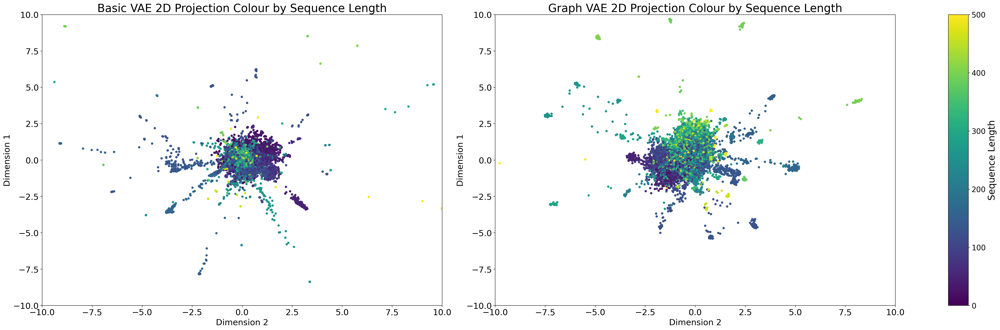

In [128]:
import matplotlib.gridspec as gridspec

def plot_scatter_map(seq_latent_coord, graph_latent_coord, color_values, vmin, vmax, colourbar_label, title):
    fig = plt.figure(figsize=(30, 10), dpi=200)
    gs = gridspec.GridSpec(1, 3, width_ratios=[1, 1, 0.05])  # Space for colorbar
    # Get the concatenated lengths for coloring
    color_values = color_values #torch.concatenate(lengths)

    ax1 = plt.subplot(gs[0])
    ax2 = plt.subplot(gs[1])
    cax = plt.subplot(gs[2])  # Colorbar axis
    s = 16
    # Create scatter plots
    sc1 = ax1.scatter(seq_latent_coord[:,0], seq_latent_coord[:,1], 
                    s=s, c=color_values, cmap='viridis', vmin=vmin, vmax=vmax)
    ax1.set_title(f'Basic VAE 2D Projection {title}', fontsize=24)

    sc2 = ax2.scatter(graph_latent_coord[:,0], graph_latent_coord[:,1], 
                    s=s, c=color_values, cmap='viridis', vmin=vmin, vmax=vmax)
    ax2.set_title(f'Graph VAE 2D Projection {title}', fontsize=24)

    # Add colorbar
    cbar = fig.colorbar(sc1, cax=cax)
    cbar.set_label(colourbar_label, fontsize=20)
    cbar.ax.tick_params(labelsize=16)

    # Adjust tick parameters
    for ax in [ax1, ax2]:
        ax.tick_params(axis="both", which="major", labelsize=18)
        ax.set_ylabel('Dimension 1', fontsize=18)
        ax.set_xlabel('Dimension 2',fontsize=18)

        ax.set_xlim(-10,10)
        ax.set_ylim(-10,10)

    plt.tight_layout()
    plt.show()
plot_scatter_map(seq_latent_coord, graph_latent_coord, torch.concatenate(lengths), 0, 500, 'Sequence Length', 'Colour by Sequence Length')

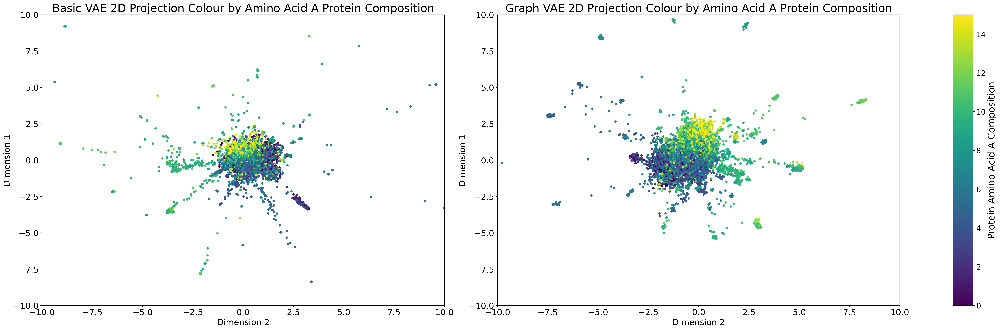

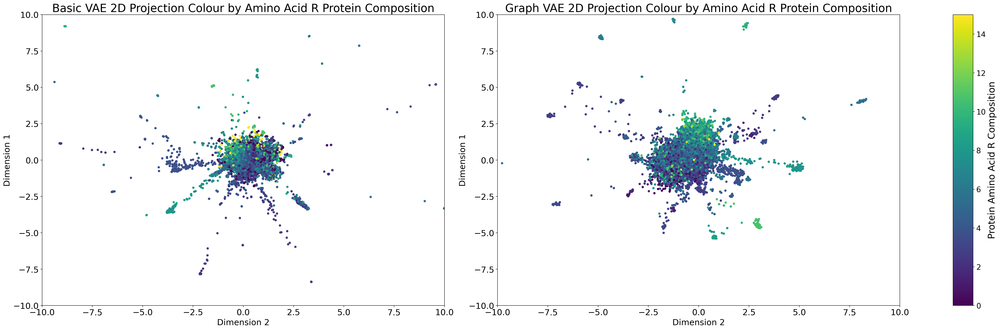

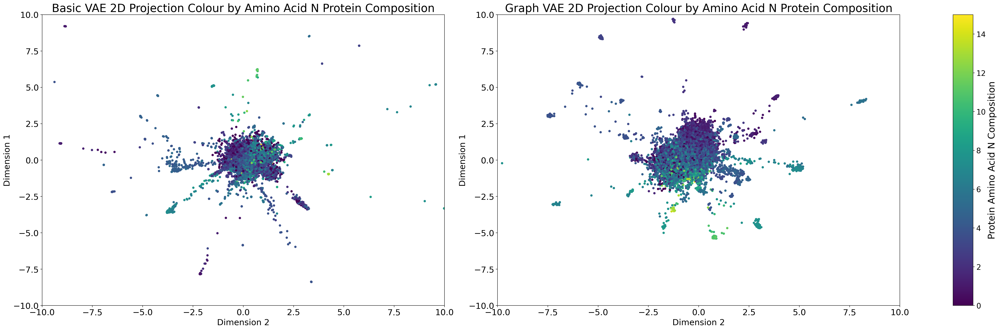

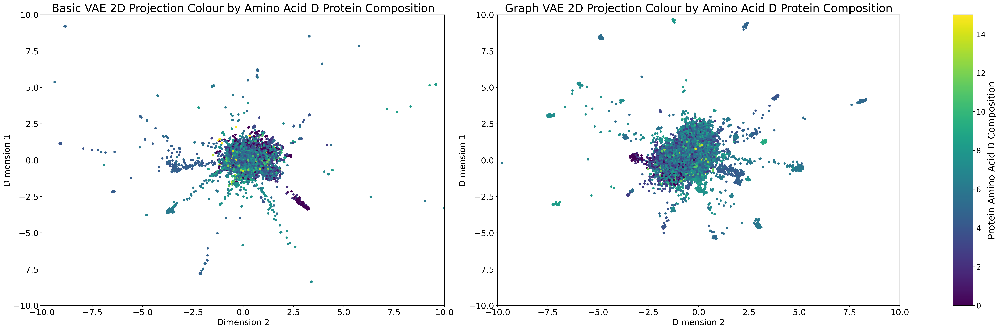

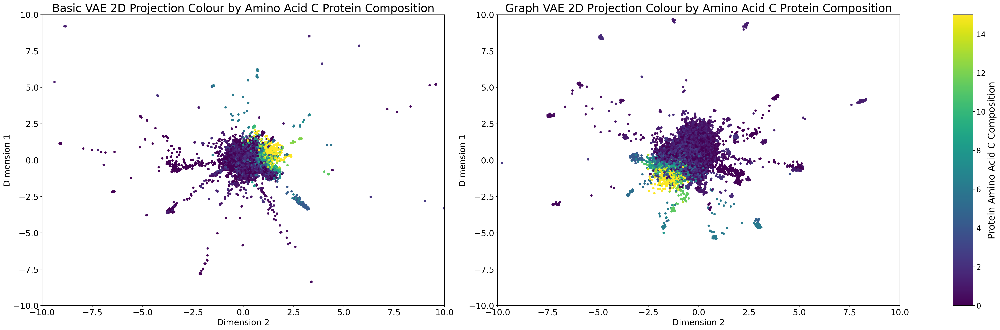

...

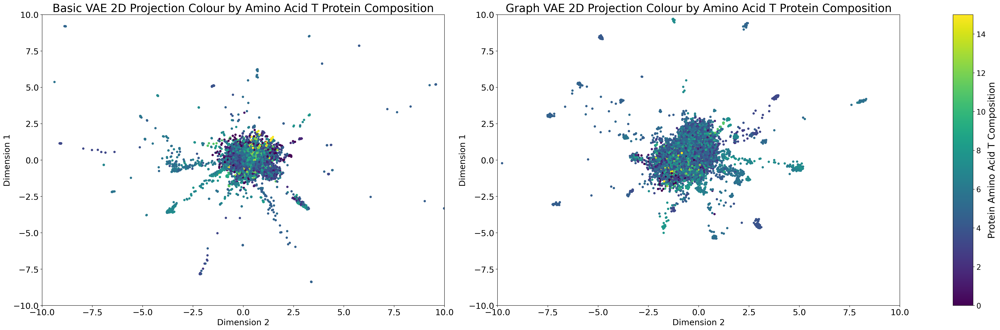

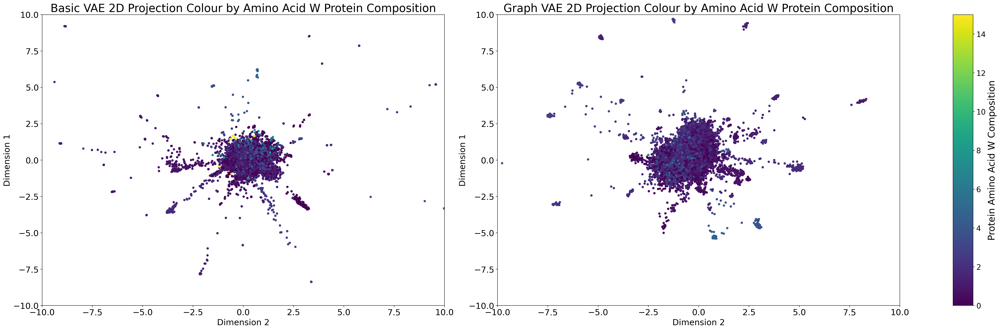

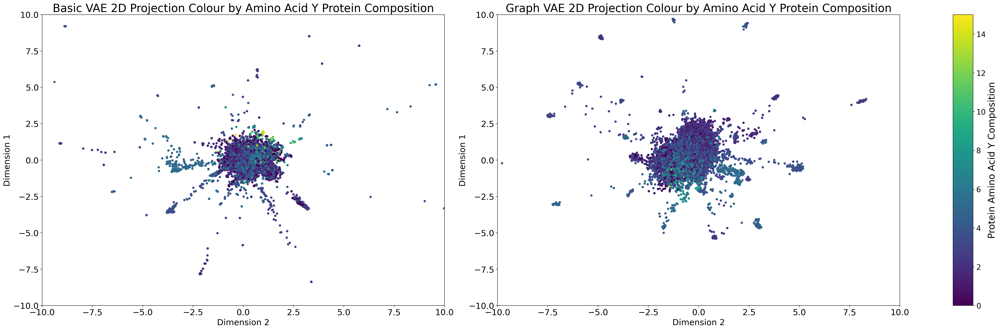

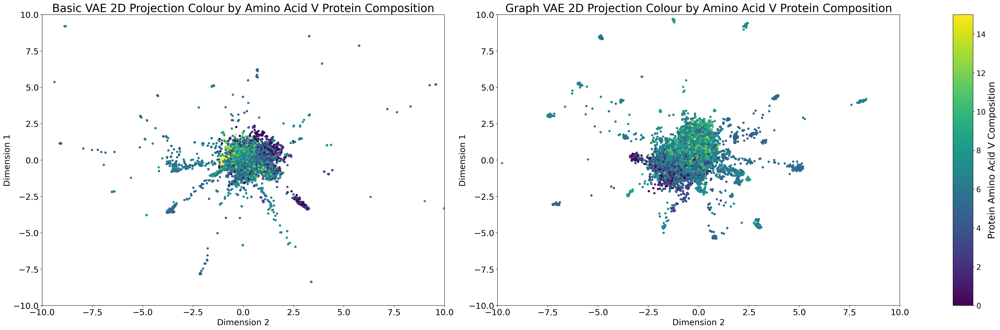

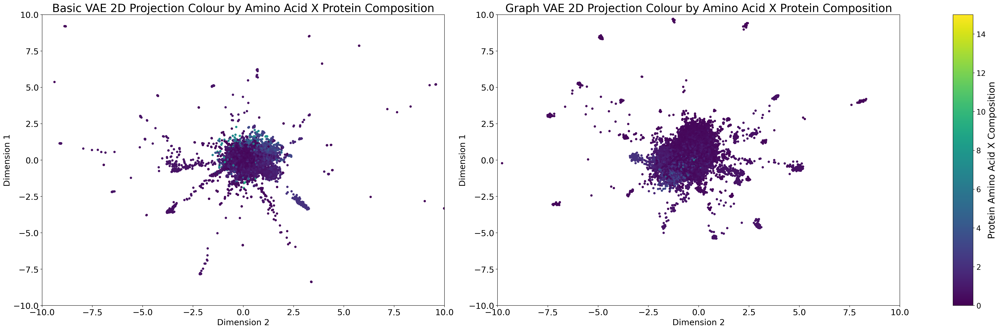

In [ ]:
amino_encoding_dict = {'A': 0,'R': 1,'N': 2,'D': 3,'C': 4,'E': 5,
                            'Q': 6,'G': 7,'H': 8,'I': 9,'L': 10,'K': 11,
                            'M': 12,'F': 13,'P': 14,'S': 15,'T': 16,
                            'W': 17,'Y': 18,'V': 19, 'X':20}

for i in range(21):
    key = next((k for k, v in amino_encoding_dict.items() if v == i), None)
    perc_i_amino = (torch.vstack(i_amino_count[i]).squeeze() / torch.concatenate(lengths))*100
    plot_scatter_map(seq_latent_coord, graph_latent_coord, perc_i_amino, 0, 15, f'Protein - Amino Acid {key} % Composition', f'Colour by Amino Acid {key} Protein Composition')

### Amino Acid Composition

#### Sequence Model

In [180]:
from Bio import pairwise2
from Bio.pairwise2 import format_alignment
original_data = list(np.concatenate(original_data))
original_rec = list(np.concatenate(original_rec))
half_rec = list(np.concatenate(half_std_rec))
full_rec = list(np.concatenate(full_std_rec))

In [181]:
from Bio.Align import PairwiseAligner
amino_encoding_dict = {'A': 0,'R': 1,'N': 2,'D': 3,'C': 4,'E': 5,
                            'Q': 6,'G': 7,'H': 8,'I': 9,'L': 10,'K': 11,
                            'M': 12,'F': 13,'P': 14,'S': 15,'T': 16,
                            'W': 17,'Y': 18,'V': 19, 'X':20}

def convert_to_string(data_indices):
    data_indices = list(data_indices)
    string = ""

    for i in data_indices:
        key = next((k for k, v in amino_encoding_dict.items() if v == i), None)

        if key == 'X':
            return string
        string += key

    return string

In [182]:
from Bio.Align import PairwiseAligner
amino_encoding_dict = {'A': 0,'R': 1,'N': 2,'D': 3,'C': 4,'E': 5,
                            'Q': 6,'G': 7,'H': 8,'I': 9,'L': 10,'K': 11,
                            'M': 12,'F': 13,'P': 14,'S': 15,'T': 16,
                            'W': 17,'Y': 18,'V': 19, 'X':20}

original_string_data = []
original_rec_string_data = []
half_rec_string_data = []
full_rec_string_data = []

for idx in range(len(original_data)):
    og_data_idx = original_data[idx].argmax(axis = -1)
    og_rec_data_idx = original_rec[idx].argmax(axis = -1)
    half_rec_data_idx = half_rec[idx].argmax(axis = -1)
    full_rec_data_idx = full_rec[idx].argmax(axis = -1)
    
    og_data_idx = convert_to_string(og_data_idx)
    og_rec_data_idx = convert_to_string(og_rec_data_idx)
    half_rec_data_idx = convert_to_string(half_rec_data_idx)
    full_rec_data_idx = convert_to_string(full_rec_data_idx)

    original_string_data.append(og_data_idx)
    original_rec_string_data.append(og_rec_data_idx)    
    half_rec_string_data.append(half_rec_data_idx)
    full_rec_string_data.append(full_rec_data_idx)


    

In [272]:
original_string_data[189]

'MDEFEMIKRNTSEIISEEELREVLKKDEKSALIGFEPSGKIHLGHYLQIKKMIDLQNAGFDIIILLADLHAYLNQKGELDEIRKIGDYNKKVFEAMGLKAKYVYGSSFQLDKDYTLNVYRLALKTTLKRARRSMELIAREDENPKVAEVIYPIMQVNPAHYQGVDVVVGGMEQRKIHMLARELLPKKVVCIHNPVLTGLDGEGKMSSSKGNFIAVDDSPEEIRAKIKKAYCPAGVVEGNPIMEIAKYFLEYPLTIKRPEKFGGDLTVNSYEELESLFKNKELHPMDLKNAVAEELIKILEPIRKRLL'

In [273]:
original_rec_string_data[189]

'MMEEKKEVVGETLVLKSALKKELLKKGGVDEGLEEIELSKRKKVKIDGGLGLLDILDTEGKEEEEIKLKLEIEELEKGLILLAIIKLLKLEEIKALLEAAKKVKKVLKVVIVVVLGKLLLLALLKLKREEEALLEKLLLKLNEESAIKKALVVDDFLLLDNLIKIERREEEDGVAGLISAEYEPFGDVGLFGALFKTRSDSALPLGHGKVVELEAGGIEEEIDAVYGLALLLLLLLRKPILSSILKTLLLAEKTKKKGLVKEDQFLFRLRPSIIEKKLFKKRDEFVGDLGLVLYSEFKGTLYTDKKMTLLLLGIIEIILKDLKLGVGGDDTLAVEEVKELLELLLYDGDGIGLIILKSKKEQGWTTVTKIPELFLKLHIATDEDHLFEELFSLPIFIDELITISDKDKKATLHPDRRMTLEEKLNSPSGLEELSGPSRYVRLVDLFAALFLIPLYRLLYLLFRNAHCEDPDELLEHHHDAWVFKG'

In [274]:
half_rec_string_data[189]

'MKEEELELVGELLVLEKLLKKELKKKGGVIEGEEEIEKLKLKKKKIDGGLELLDILEDEEKEEEEIELKLIKEELEKILILLAILKLLKLEEEKELLELAKKKKKVLKLVLVEELLKLLLLALLKLKEEEEKLLEKLLLKLKEESEIVKKLVVLKALLLENLIKEEREEEEDGVLGLDSEEYELGGDIELLGLLLKLRELSALPLGGGKVVLLSVGGLEEEIDAVILLLLLLLLLLLKKILKSILKKLLLAEKEKKKLLVKEDDFLRFLRLSRILKKKFKKRDEGVLDLGLVLELEFKLLLITDKKKTLLLLGIIEEILKDLKLGVGKSDFLAEEEVKELLELLLYEGDGIGLDILKSKEEQGFTEVLKIPELFLKLEIATDEDFLFEELASLEIFIDELIRISDKDKKKILHPDMMMILEEELNKPSNLEELSGPSRAVRLVDLFSAKFLLPLYYLLLYKFGAMHPEDSDKLLEA'

In [275]:
full_rec_string_data[189]

'MKEEELELVLELKELEELLKKLLLKKKLKLEEEEEIELLKLKKKKKKGKEELLEKEELEEKEEEEEELLLLKEELEKILILLALLEELLLEELKELLKLLKKLKKKLKLLLEEELLLLLLLLLLLLKEEEEKKLLKLLLLLLEEKELVKKLLLLKELLLLLLTKEEREEEEELELLLELLELELEEDIELLLLLLKLRELSLLLLGLGKVVLLSVGKLEEEIEAVILLLLLLLLLLLKKILKEILKKLLLKLKEDKKLLKLEDLLLLLLRLSLILLKKLKELLEVVLDLKLELELELKLLLKLDKKLTLLLLGTIEEILKLLDLLVAKSSLLEEEELKELLELLLYEGDFELLKILKSKEEQEDREVEKIIEEELLLEEATDLDSLLEELESLEILIDELITISDKKKKKELEEDEMMILEEKLIKPSNLAELSGVSRAVRLVDLISAKFLLPKYYLLFYKFGAMHPEDSDKLLEA'

In [279]:
aligner.align(original_string_data[189], half_rec_string_data[189]).score / len(original_string_data[189])

2.8273615635179152

In [245]:
from Bio.Align import substitution_matrices
aligner = PairwiseAligner()
aligner.mode = "local"  
aligner.substitution_matrix = substitution_matrices.load("BLOSUM90")
# aligner.match_score = 2
# aligner.mismatch_score = -1
# aligner.open_gap_score = -2
# aligner.extend_gap_score = -0.5

og_to_og_rec = []
og_to_half_rec = []
og_to_full_rec = []

for idx in range(len(original_string_data)):

    seq1 = original_string_data[idx]

    seq_og_rec = original_rec_string_data[idx]
    seq_half_rec = half_rec_string_data[idx]
    seq_full_rec = full_rec_string_data[idx]

    # Perform local alignment
    alignments_og_to_og_rec = aligner.align(seq1, seq_og_rec)

    if (alignments_og_to_og_rec.score / len(seq1)) > 2.8:
    
        alignments_og_to_half_rec = aligner.align(seq1, seq_half_rec)
        alignments_og_to_full_rec = aligner.align(seq1, seq_full_rec)

        og_to_og_rec.append(alignments_og_to_og_rec.score / len(seq1))
        og_to_half_rec.append(alignments_og_to_half_rec.score / len(seq1))
        og_to_full_rec.append(alignments_og_to_full_rec.score / len(seq1))
            
    # else:
    #     continue

In [246]:
np.array(og_to_full_rec).mean()

3.57447980681796

In [247]:
np.array(og_to_half_rec).mean()

3.750323019772225

In [248]:
np.array(og_to_og_rec).mean()

3.913431983669892

In [ ]:
aligner = PairwiseAligner()
aligner.mode = "global"  
aligner.substitution_matrix = substitution_matrices.load("BLOSUM90")
kog_to_og_rec = []
kog_to_half_rec = []
kog_to_full_rec = []

for idx in range(len(original_string_data)):

    seq1 = original_string_data[idx]

    seq_og_rec = original_rec_string_data[idx]
    seq_half_rec = half_rec_string_data[idx]
    seq_full_rec = full_rec_string_data[idx]

    # Perform local alignment
    alignments_og_to_og_rec = aligner.align(seq1, seq_og_rec)
    alignments_og_to_half_rec = aligner.align(seq1, seq_half_rec)
    alignments_og_to_full_rec = aligner.align(seq1, seq_full_rec)

    kog_to_og_rec.append(alignments_og_to_og_rec.score)
    kog_to_half_rec.append(alignments_og_to_half_rec.score)
    kog_to_full_rec.append(alignments_og_to_full_rec.score)

In [241]:
np.array(kog_to_og_rec).mean()

458.08549267851555

In [242]:
np.array(kog_to_half_rec).mean()

462.31654551146045

In [243]:
np.array(kog_to_full_rec).mean()

491.9593405446767

In [204]:
for i in original_string_data:
    print(i)

NLYFQSSMSRVLQAEELHEKALDPFLLQAEFFEIPMNFVDPKEYDIPGLVRKNRYKTILPNPHSRVCLTSPDPDDPLSSYINANYIRGYGGEEKVYIATQGPIVSTVADFWRMVWQEHTPIIVMITTEYWPEEQVAYDGVEITVQKVIHTEDYRLRLISLKSEERGLKHYWFTSWPDQKTPDRAPPLLHLVREVEEAAQQEGPHCAPIIVHSSAGIGRTGCCFIATSICCQQLRQEGVVDILKTTCQLRQDRGGMIQTCEQYQFVHHVMSLYEKQLS
DPEALAAEIGPVKQVSSLGEQIDAALAQQGEQLFNNTYCTACHRLDERFIGPALRDVTKRRRGPVYIMNVMLNPNGMIQRHPVMKQLVQEYGTMMTTDMALSSEEQARAILEYLRQVAENQ
KVFERCELARTLKRLGMDGYRGISLANWMCLAKWESGYNTRATNYNAGDRSTDYGIFQINSRYWCNDGKTPGAVNACHLSCSALLQDNIADAVACAKRVVRDPQGIRAWLAWRNRCQNRDVRQYVQGCGV
SFRIAAIPGDGIGLEVLPEGIRVLEAAALKHGLALEFDTFEWASCDYYLQHGKMMPDDWAEQLKQYDAIYFGAVGWPDKVPDHISLWGSLLKFRREFDQYVNIRPVRLFPGVPCALANRKVGDIDFVVVRENTEGEYSSLGGIMFENTENEIVIQESIFTRRGVDRILKYAFDLAEKRERKHVTSATKSNGMAISMPYWDKRTEAMAAHYPHVSWDKQHIDILCARFVLQPERFDVVVASNLFGDILSDLGPACAGTIGIAPSANLNPERNFPSLFEPVHGSAPDIFGKNIANPIAMIWSGALMLEFLGQGDERYQRAHDDMLNAIERVIADGSVTPDMGGTLSTQQVGAAISDTLARL
IRMDKKSLYKYLLLRSTGDMHKAKSPTIMTRVTNNVYLGNYKNAMDAPSSEVKFKYVLNLTMDKYTLPNSNINIIHIPLVDDTTTDISKYFDDVTAFLSKCDQRNEPVL